In [1]:
import numpy as np
from matplotlib import pyplot as plt
from IPython.display import display, Latex

import glob
from astropy.io import fits

%matplotlib inline
%config InlineBackend.figure_format='retina'
#!pip install git+https://github.com/M-Bianchi/My_matplotlib_style
plt.style.use('mystyle')

In [2]:
path = "Data/20231011/"
filenames = glob.glob(path + '*fit')

In [3]:
hdu = fits.open(path + 'ngc6946_r_083.fit')
hdu.info()

Filename: Data/20231011/ngc6946_r_083.fit
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      25   (4499, 3599)   int16 (rescales to uint16)   


In [4]:
hdu[0].header

SIMPLE  =                    T                                                  
BITPIX  =                   16                                                  
NAXIS   =                    2                                                  
NAXIS1  =                 4499                                                  
NAXIS2  =                 3599                                                  
BZERO   =           32768.000000                                                
BSCALE  =             1.000000                                                  
DATAMIN =             0.000000                                                  
DATAMAX =           65535.000000                                                
INSTRUME=           'ATIK-16200: fw rev 3.52'                                   
FILTER  =           'Position 6'                                                
EXPTIME =           600.000                                                     
DATE-OBS=           '2023-10

<class 'numpy.ndarray'>
(3599, 4499)
[[18172 17893 18066 ... 17310 17170 17418]
 [18022 17994 18211 ... 17071 16786 17338]
 [18118 17711 17798 ... 17134 16921 17535]
 ...
 [19955 20399 19877 ... 19318 19015 19462]
 [19659 19849 20110 ... 19583 19355 19114]
 [20463 20093 20135 ... 19814 19349 19486]]


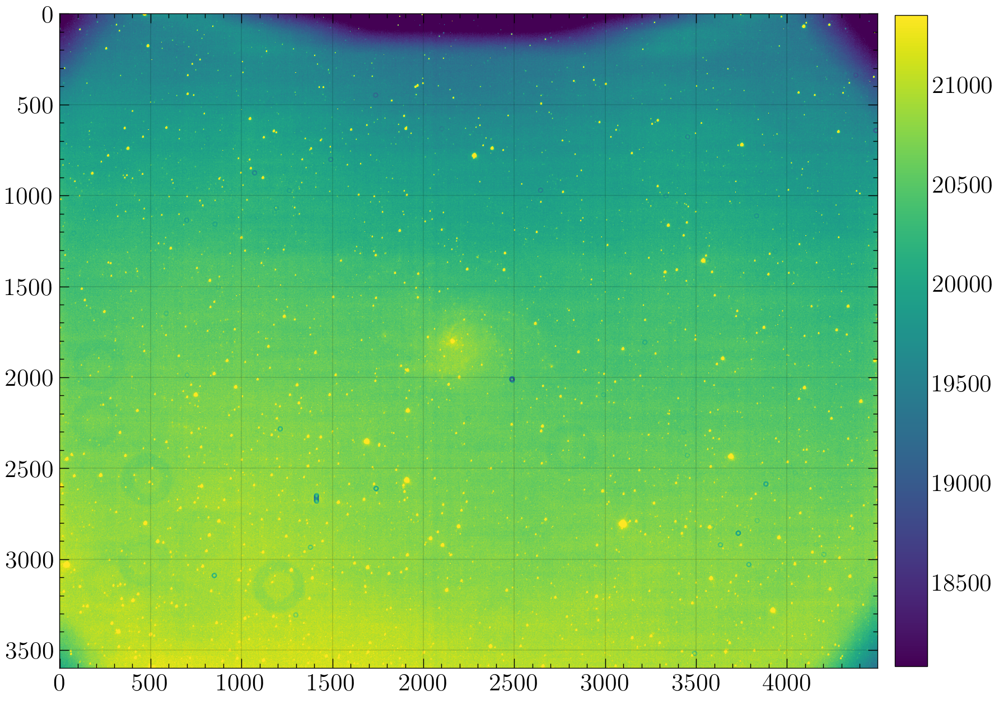

In [5]:
science_image = hdu[0].data

print(type(science_image))
print(science_image.shape)
print(science_image)

plt.imshow(science_image, clim=np.quantile(science_image, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

# Bias frame

The bias is a frame with the telescope dome closed and zero exposure time.\
The result is not of zero counts, as one may expect, due to the fact that we are applying a baseline voltage to each pixel in order to be in the linear regime.\
It should be a constant baseline of counts (with an uncertainty given by the readout noise) that can be subtracted from the scientific image.\
We consider the average of multiple bias frames to reduce the uncertainty on the bias (thanks to Central Limit Theorem), which obviously is not removable by just subtracting the bias.

Shape of allbias (2, 3599, 4499)
Shape of meanbias (3599, 4499)


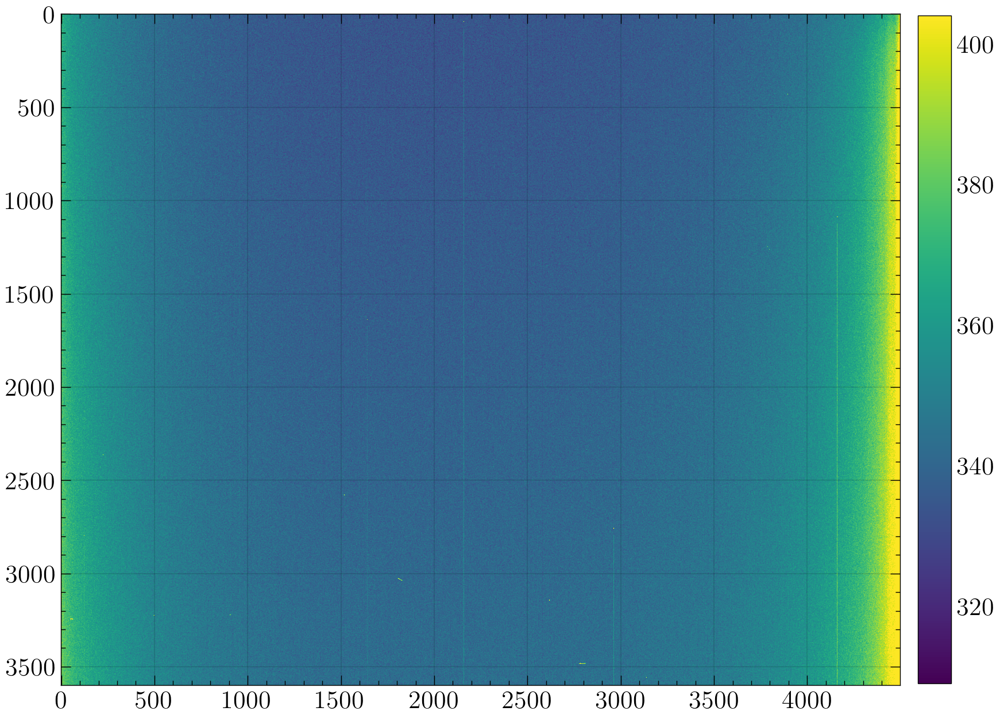

In [6]:
allbias = []

for i, filename in enumerate (filenames):
    if('bias' in filenames[i]):
        mybias = fits.open(filename)
        allbias.append(mybias[0].data)
        mybias.close(filename)
        
allbias = np.array(allbias)
print('Shape of allbias', allbias.shape)

meanbias = np.mean(allbias, axis=0)
print('Shape of meanbias', meanbias.shape)
plt.imshow(meanbias, clim=np.quantile(meanbias, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

# Dark frame

We read the detector after some time of no light going in, measuring the dark current counts (+ the bias, of course).\
We can repeat the measure for different exposure times, obtaining a curve of the dark current counts as a function of the exposure time.

Shape of alldark1. (6, 3599, 4499)
Shape of alldark10. (14, 3599, 4499)
Shape of alldark100. (8, 3599, 4499)
Shape of alldark1000. (15, 3599, 4499)


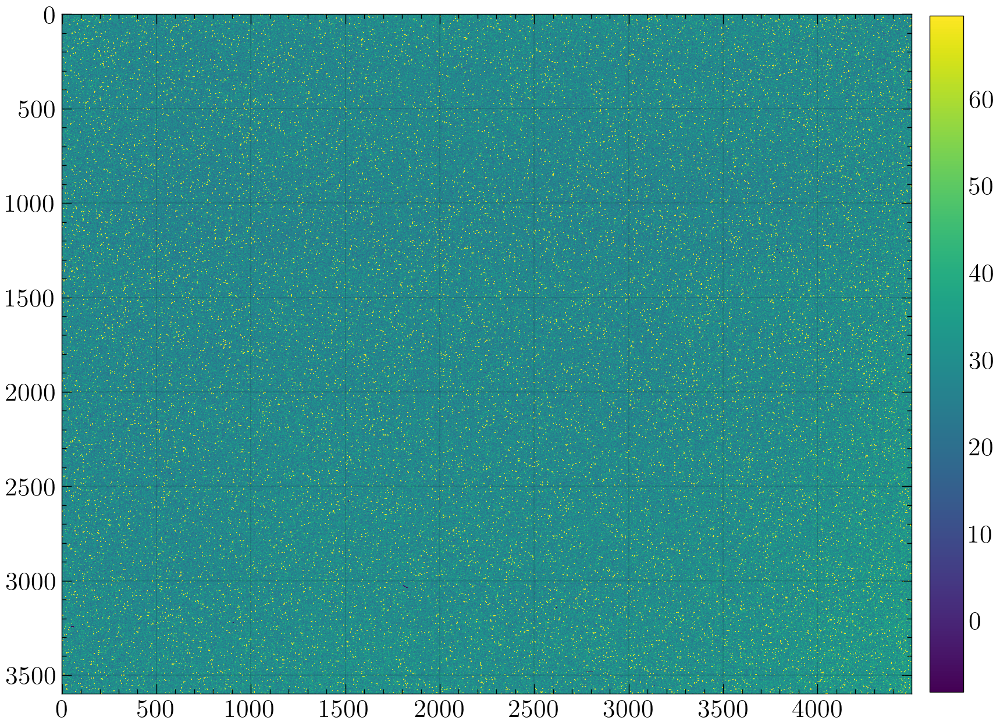

In [7]:
def Dark_frame(filenames, darkname):

    alldark = []

    for i, filename in enumerate (filenames):
        if(darkname in filenames[i]):
            mydark = fits.open(filename)
            alldark.append(mydark[0].data)
            mydark.close(filename)

    alldark = np.array(alldark)
    print('Shape of all'+darkname, alldark.shape)

    return np.mean(alldark, axis=0)

    
meandark1 = Dark_frame(filenames, 'dark1.')
meandark10 = Dark_frame(filenames, 'dark10.')
meandark100 = Dark_frame(filenames, 'dark100.')
meandark1000 = Dark_frame(filenames, 'dark1000.')

meandarkplot = meandark1000 - meanbias    
plt.imshow(meandarkplot, clim=np.quantile(meandarkplot, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

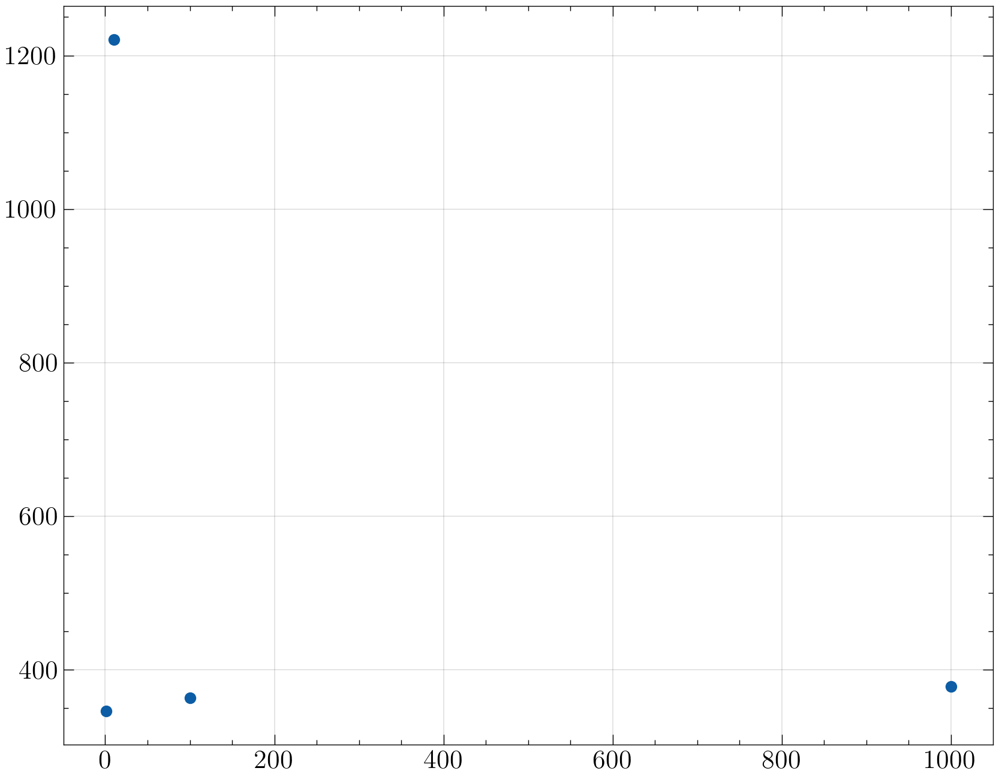

In [8]:
dark_texp = np.array([1, 10, 100, 1000])

plt.plot(dark_texp, np.array([np.mean(meandark1), np.mean(meandark10), np.mean(meandark100), np.mean(meandark1000)]), 'o');

# Flat frame

Not all the pixels have the same response. Often the edges of the detector are less responsive. There may also be some dead columns, due to manufacturing faults or accidental damage.\
One way to produce a flat is to observe the sky at sunset, assuming a uniform flux. Another way is to use a lamp (this is what we will do).\
The flat must be normalized such that the average value is one.

Shape of allflat (1, 3599, 4499)
Shape of meanflat (3599, 4499)


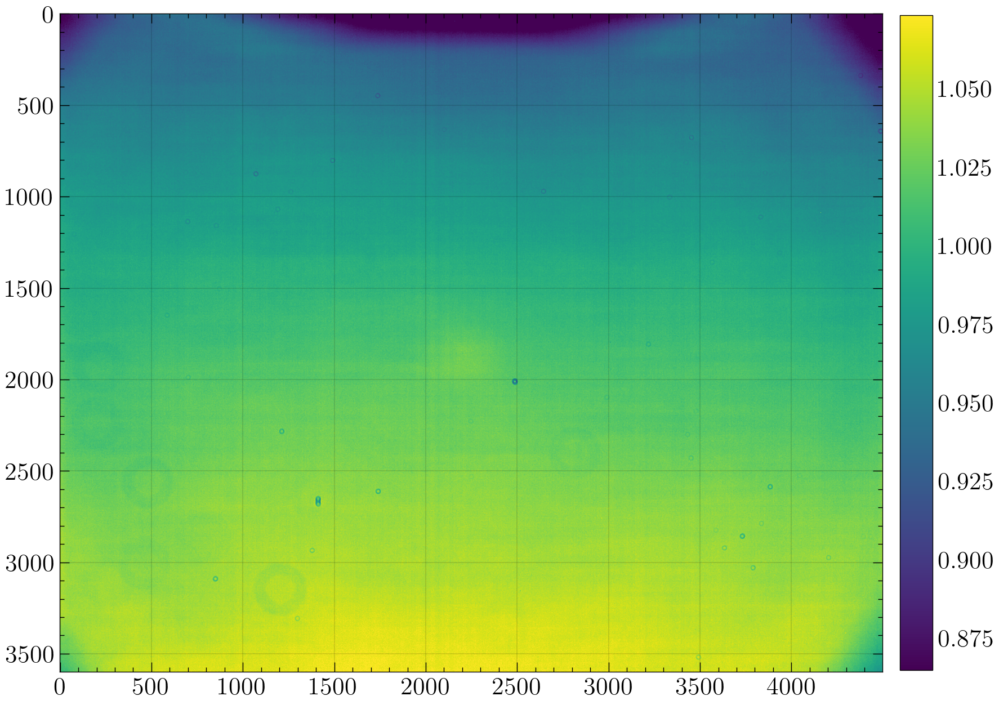

In [17]:
allflat = []

for i, filename in enumerate (filenames):
    if('flat' in filenames[i]):
        myflat = fits.open(filename)
        allflat.append(myflat[0].data)
        myflat.close(filename)
        
allflat = np.array(allflat)
print('Shape of allflat', allflat.shape)

meanflat = np.mean(allflat, axis=0)
normalized_meanflat = meanflat / np.mean(meanflat)
print('Shape of meanflat', meanflat.shape)

plt.imshow(normalized_meanflat, clim=np.quantile(normalized_meanflat, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

# Applying corrections

<font color='red'>Should we subtract the bias also from the flat?</font>

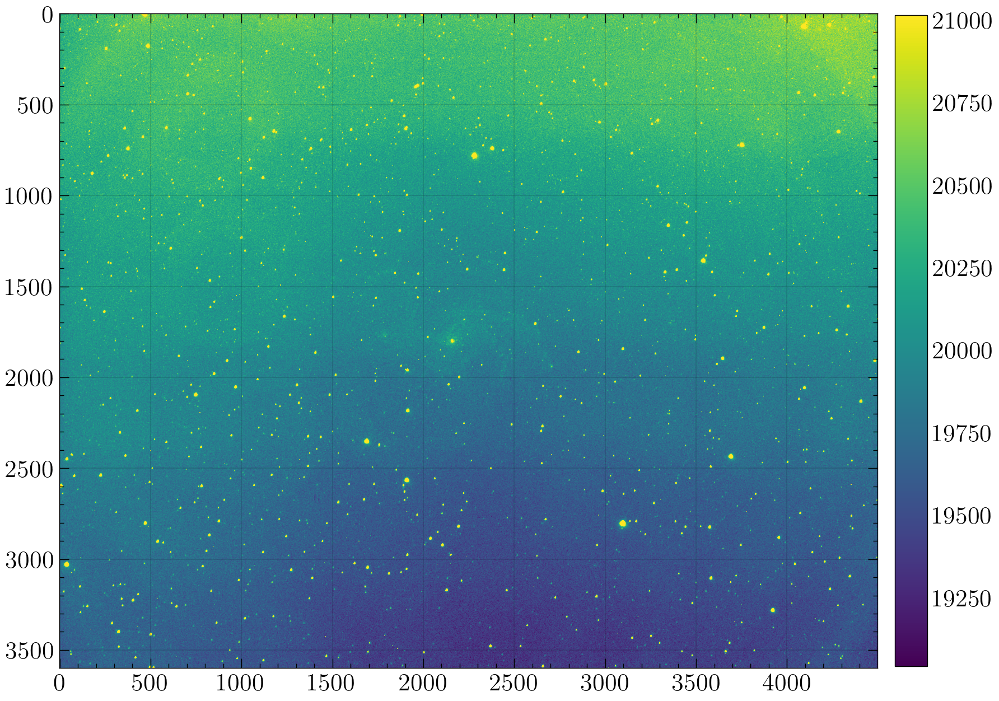

In [10]:
science_image_corrected = (science_image - meanbias) / normalized_meanflat

plt.imshow(science_image_corrected, clim=np.quantile(science_image_corrected, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

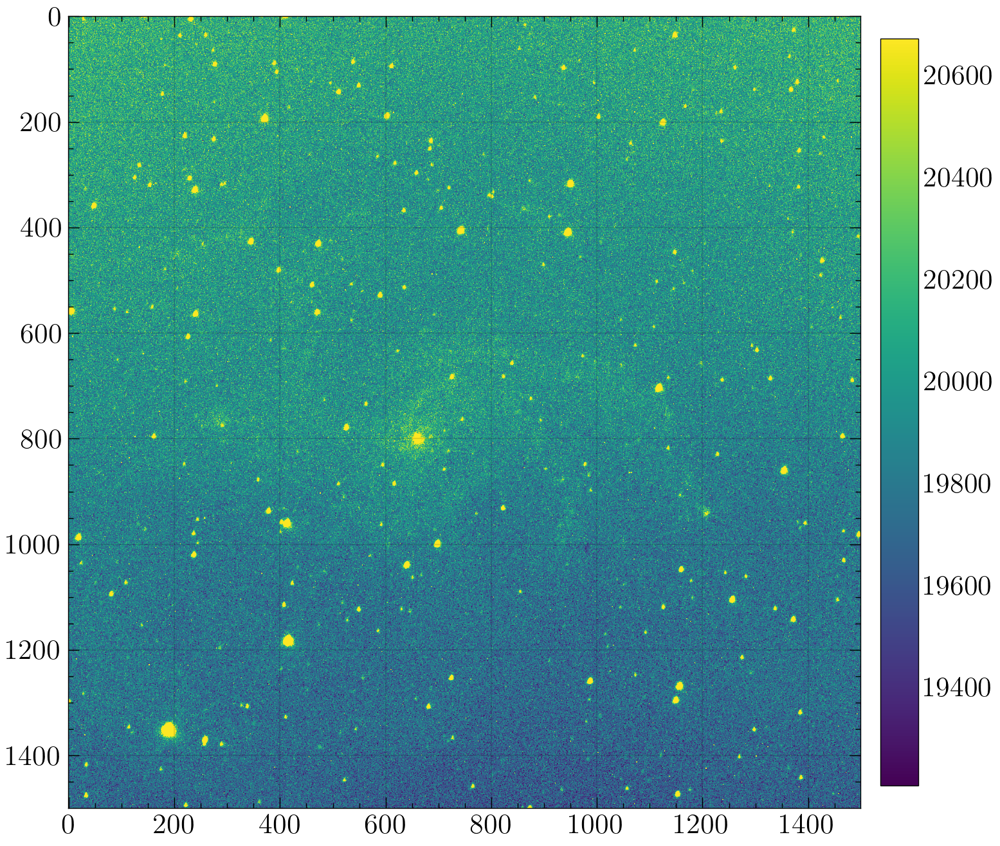

In [11]:
science_image_cropped = science_image_corrected[1000:2500, 1500:3000]
plt.imshow(science_image_cropped, clim=np.quantile(science_image_cropped, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

In [12]:
science_image_corrected.shape

(3599, 4499)

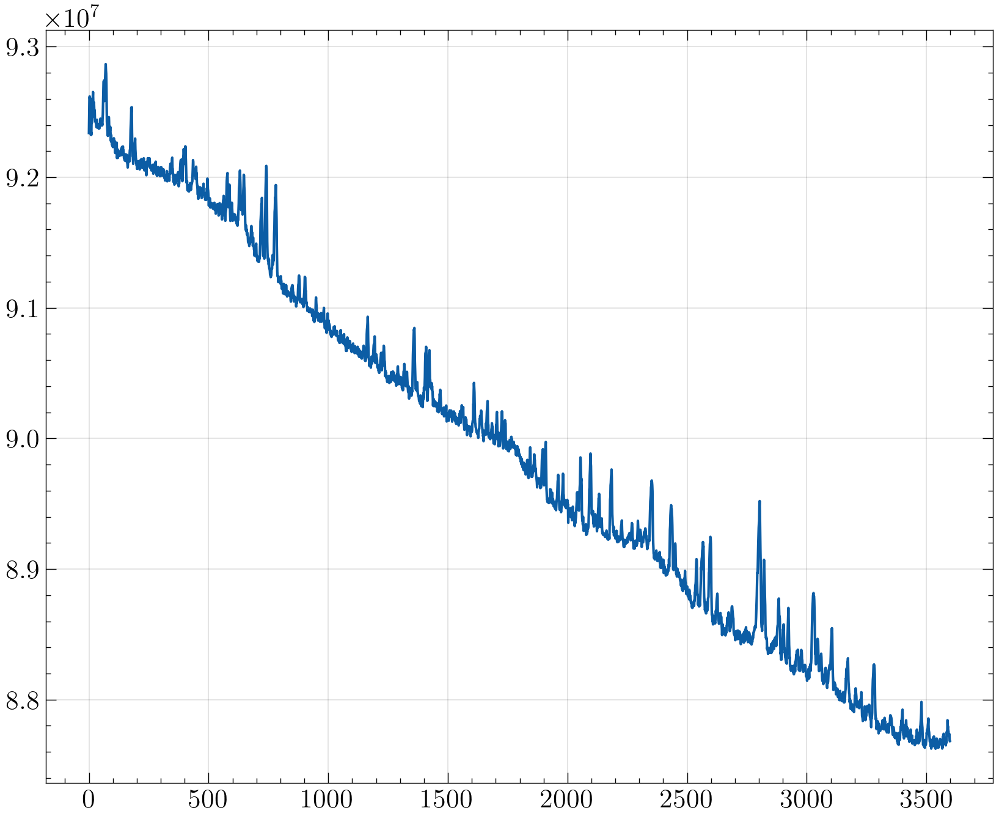

In [13]:
x_plot = np.arange(0, science_image_corrected.shape[0])
y_plot = np.sum(science_image_corrected, axis=1)
plt.plot(x_plot, y_plot);

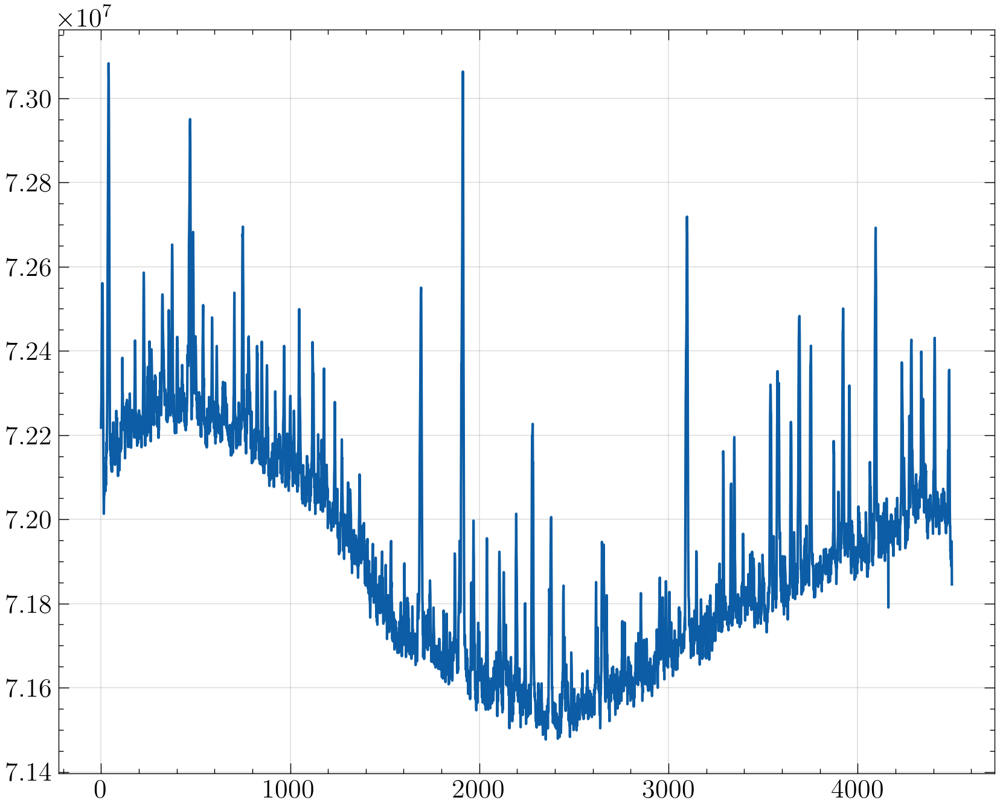

In [14]:
x_plot = np.arange(0, science_image_corrected.shape[1])
y_plot = np.sum(science_image_corrected, axis=0)
plt.plot(x_plot, y_plot);

# Stacking

Shape of allbias (3, 3599, 4499)
Shape of meanbias (3599, 4499)


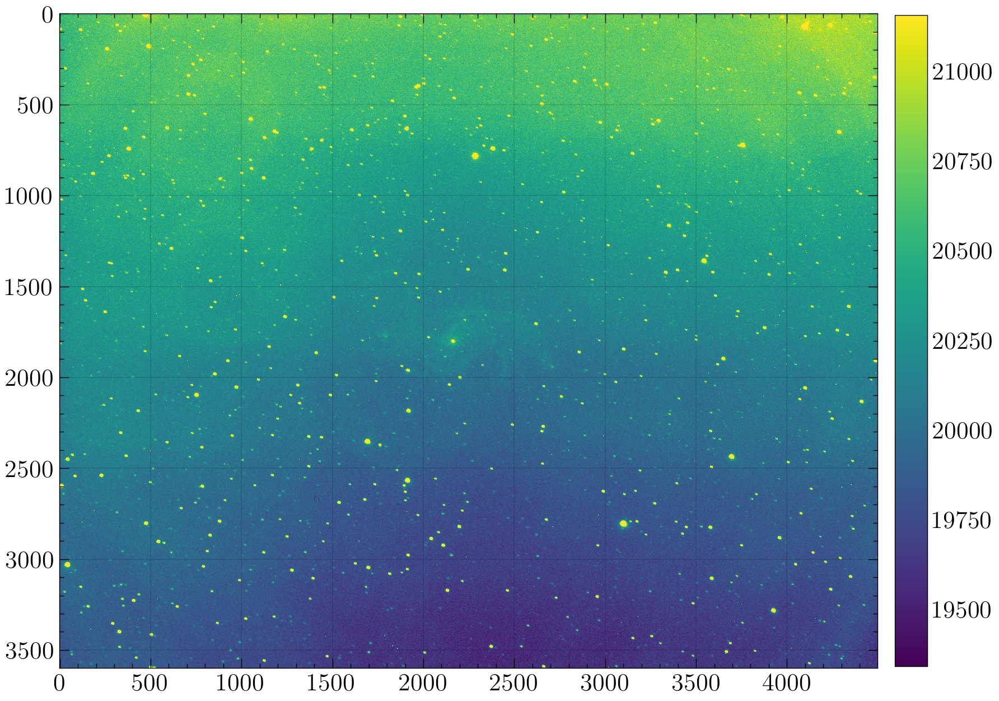

In [15]:
allimage = []

for i, filename in enumerate (filenames):
    if('ngc6946_r' in filenames[i]):
        myimage = fits.open(filename)
        allimage.append(myimage[0].data)
        myimage.close(filename)
        
allimage = np.array(allimage)
print('Shape of allbias', allimage.shape)

meanimage = np.mean(allimage, axis=0)
print('Shape of meanbias', meanimage.shape)

meanimage_corrected = (meanimage - meanbias) / normalized_meanflat
plt.imshow(meanimage_corrected, clim=np.quantile(meanimage_corrected, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);